<a href="https://colab.research.google.com/github/marcellabittencourt/Monografia/blob/main/TCC8_Compilados_PosBanca.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Libraries
import sys
import scipy
import numpy as np
import matplotlib 
import sklearn
import seaborn as sn

# Load libraries
import pandas as pd
from pandas.plotting import scatter_matrix
import matplotlib.pyplot as plt
from sklearn import model_selection
from sklearn import metrics
from sklearn import tree
from sklearn import svm
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split #train_test_split #KFold
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import PolynomialFeatures
from IPython.display import Image 
import pydotplus
import matplotlib.image as mpimg
from six import StringIO
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import r2_score
from xgboost import XGBRegressor
from datetime import datetime

# TRABALHO COM R2 NEGATIVO
#https://repositorio.pucgoias.edu.br/jspui/bitstream/123456789/1626/1/CONTROLE%20DE%20ESTOQUE%20UTILIZANDO%20REDES%20NEURAIS.pdf 

In [ ]:
import pandas as pd
import io
from google.colab import files 
uploaded = files.upload()
df = pd.read_csv(io.BytesIO(uploaded['data.csv']))

Saving data.csv to data.csv


In [ ]:
# Excluindo Colunas que não serão utilizadas (YRMODAHRMI	, Season)
df.drop(["YRMODAHRMI", "Season"], axis=1, inplace=True)
print(df.head(5)) # Mostrando as 5 primeiras Linhas do df Alterado
print(df.shape)   # Mostrando o tamanho do df (Linhas,Colunas)
print(df.dtypes)  # Mostrando o tipo de dado de cada Coluna

      Location      Date  Time  Latitude  Longitude  Altitude  Month  Hour  \
0  Camp Murray  20171203  1145     47.11    -122.57        84     12    11   
1  Camp Murray  20171203  1315     47.11    -122.57        84     12    13   
2  Camp Murray  20171203  1330     47.11    -122.57        84     12    13   
3  Camp Murray  20171204  1230     47.11    -122.57        84     12    12   
4  Camp Murray  20171204  1415     47.11    -122.57        84     12    14   

   Humidity  AmbientTemp  PolyPwr  Wind.Speed  Visibility  Pressure  \
0  81.71997     12.86919  2.42769           5        10.0    1010.6   
1  96.64917      9.66415  2.46273           0        10.0    1011.3   
2  93.61572     15.44983  4.46836           5        10.0    1011.6   
3  77.21558     10.36659  1.65364           5         2.0    1024.4   
4  54.80347     16.85471  6.57939           3         3.0    1023.7   

   Cloud.Ceiling  
0            722  
1             23  
2             32  
3              6  
4        

In [ ]:
df["DateTime"] = df["Date"].astype(str) + df["Time"].astype(str)
df["DateTime"] = pd.to_datetime(df["DateTime"], format='%Y%m%d%H%M')
df.drop(["Date", "Time"], axis=1, inplace=True)
pd.get_dummies("DateTime")
print(df.head(5)) # Mostrando as 5 primeiras Linhas do df Alterado
print(df.shape)   # Mostrando o tamanho do df (Linhas,Colunas)
print(df.dtypes)  # Mostrando o tipo de dado de cada Coluna

      Location  Latitude  Longitude  Altitude  Month  Hour  Humidity  \
0  Camp Murray     47.11    -122.57        84     12    11  81.71997   
1  Camp Murray     47.11    -122.57        84     12    13  96.64917   
2  Camp Murray     47.11    -122.57        84     12    13  93.61572   
3  Camp Murray     47.11    -122.57        84     12    12  77.21558   
4  Camp Murray     47.11    -122.57        84     12    14  54.80347   

   AmbientTemp  PolyPwr  Wind.Speed  Visibility  Pressure  Cloud.Ceiling  \
0     12.86919  2.42769           5        10.0    1010.6            722   
1      9.66415  2.46273           0        10.0    1011.3             23   
2     15.44983  4.46836           5        10.0    1011.6             32   
3     10.36659  1.65364           5         2.0    1024.4              6   
4     16.85471  6.57939           3         3.0    1023.7              9   

             DateTime  
0 2017-12-03 11:45:00  
1 2017-12-03 13:15:00  
2 2017-12-03 13:30:00  
3 2017-12-04 1

In [ ]:
## Dividindo em 12 grupos -> por Local 
## Cada grupo tem um tamanho (quantidade de linhas diferente)

groups = df.groupby(df.Location)

Camp_Murray = groups.get_group("Camp Murray")    #1
Grissom = groups.get_group("Grissom")            #2
Hill_Weber = groups.get_group("Hill Weber")      #3
JDMT = groups.get_group("JDMT")                  #4
Kahului = groups.get_group("Kahului")            #5
Malmstrom = groups.get_group("Malmstrom")        #6
March_AFB = groups.get_group("March AFB")        #7
MNANG = groups.get_group("MNANG")                #8
Offutt = groups.get_group("Offutt")              #9
Peterson = groups.get_group("Peterson")          #10
Travis = groups.get_group("Travis")              #11
USAFA = groups.get_group("USAFA")                #12

print("Camp Murray shape => ", Camp_Murray.shape) 
print("Grissom shape => ", Grissom.shape) 
print("Hill Weber shape => ", Hill_Weber.shape) 
print("JDMT shape => ", JDMT.shape) 
print("Kahului shape => ", Kahului.shape) 
print("Malmstrom shape => ", Malmstrom.shape) 
print("March_AFB shape => ", March_AFB.shape) 
print("MNANG shape => ", MNANG.shape) 
print("Offutt shape => ", Offutt.shape) 
print("Peterson shape => ", Peterson.shape) 
print("Travis shape => ", Travis.shape) 
print("USAFA shape => ", USAFA.shape)


Camp Murray shape =>  (1113, 14)
Grissom shape =>  (1487, 14)
Hill Weber shape =>  (2384, 14)
JDMT shape =>  (1779, 14)
Kahului shape =>  (941, 14)
Malmstrom shape =>  (1517, 14)
March_AFB shape =>  (2204, 14)
MNANG shape =>  (780, 14)
Offutt shape =>  (881, 14)
Peterson shape =>  (2640, 14)
Travis shape =>  (2746, 14)
USAFA shape =>  (2573, 14)


In [ ]:
## Dividindo os grupos
## Camp Murray  1

features = ['Latitude',	'Longitude',	'Altitude',	'Month', 'Hour',	'Humidity',	'AmbientTemp','Wind.Speed',	'Visibility',	'Pressure',	'Cloud.Ceiling', 'DateTime']
X1 = Camp_Murray[features]
y1 = np.array(Camp_Murray['PolyPwr']).reshape(-1, 1)

X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date1 = Camp_Murray['DateTime']
date1_train, date1_test = train_test_split(date1, test_size=0.3, shuffle=False)

# Árvore Grissom  2
X2 = Grissom[features]
y2 = np.array(Grissom['PolyPwr']).reshape(-1, 1)

X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date2 = Grissom['DateTime']
date2_train, date2_test = train_test_split(date2, test_size=0.3, shuffle=False)

# Árvore Hill_Weber  3
X3 = Hill_Weber[features]
y3 = np.array(Hill_Weber['PolyPwr']).reshape(-1, 1)

X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date3 = Hill_Weber['DateTime']
date3_train, date3_test = train_test_split(date3, test_size=0.3, shuffle=False)

# Árvore JDMT  4
X4 = JDMT[features]
y4 = np.array(JDMT['PolyPwr']).reshape(-1, 1)

X4_train, X4_test, y4_train, y4_test = train_test_split(X4, y4, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date4 = JDMT['DateTime']
date4_train, date4_test = train_test_split(date4, test_size=0.3, shuffle=False)
                                                        
# Árvore Kahului  5
X5 = Kahului[features]
y5 = np.array(Kahului['PolyPwr']).reshape(-1, 1)

X5_train, X5_test, y5_train, y5_test = train_test_split(X5, y5, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date5 = Kahului['DateTime']
date5_train, date5_test = train_test_split(date5, test_size=0.3, shuffle=False)

# Árvore Malmstrom  6
X6 = Malmstrom[features]
y6 = np.array(Malmstrom['PolyPwr']).reshape(-1, 1)

X6_train, X6_test, y6_train, y6_test = train_test_split(X6, y6, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date6 = Malmstrom['DateTime']
date6_train, date6_test = train_test_split(date6, test_size=0.3, shuffle=False)

# Árvore March_AFB  7
X7 = March_AFB[features]
y7 = np.array(March_AFB['PolyPwr']).reshape(-1, 1)

X7_train, X7_test, y7_train, y7_test = train_test_split(X7, y7, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date7 = March_AFB['DateTime']
date7_train, date7_test = train_test_split(date7, test_size=0.3, shuffle=False)

# Árvore MNANG  8
X8 = MNANG[features]
y8 = np.array(MNANG['PolyPwr']).reshape(-1, 1)

X8_train, X8_test, y8_train, y8_test = train_test_split(X8, y8, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date8 = MNANG['DateTime']
date8_train, date8_test = train_test_split(date8, test_size=0.3, shuffle=False)

# Árvore Offutt  9
X9 = Offutt[features]
y9 = np.array(Offutt['PolyPwr']).reshape(-1, 1)

X9_train, X9_test, y9_train, y9_test = train_test_split(X9, y9, test_size=0.3, shuffle=False) # 70% treino e 30% teste


date9 = Offutt['DateTime']
date9_train, date9_test = train_test_split(date9, test_size=0.3, shuffle=False)

# Árvore Peterson  10
X10 = Peterson[features]
y10 = np.array(Peterson['PolyPwr']).reshape(-1, 1)

X10_train, X10_test, y10_train, y10_test = train_test_split(X10, y10, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date10 = Peterson['DateTime']
date10_train, date10_test = train_test_split(date10, test_size=0.3, shuffle=False)

# Árvore Travis  11
X11 = Travis[features]
y11 = np.array(Travis['PolyPwr']).reshape(-1, 1)

X11_train, X11_test, y11_train, y11_test = train_test_split(X11, y11, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date11 = Travis['DateTime']
date11_train, date11_test = train_test_split(date11, test_size=0.3, shuffle=False)

# Árvore USAFA  12
X12 = USAFA[features]
y12 = np.array(USAFA['PolyPwr']).reshape(-1, 1)

X12_train, X12_test, y12_train, y12_test = train_test_split(X12, y12, test_size=0.3, shuffle=False) # 70% treino e 30% teste

date12 = USAFA['DateTime']
date12_train, date12_test = train_test_split(date12, test_size=0.3, shuffle=False)



/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:16:08] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


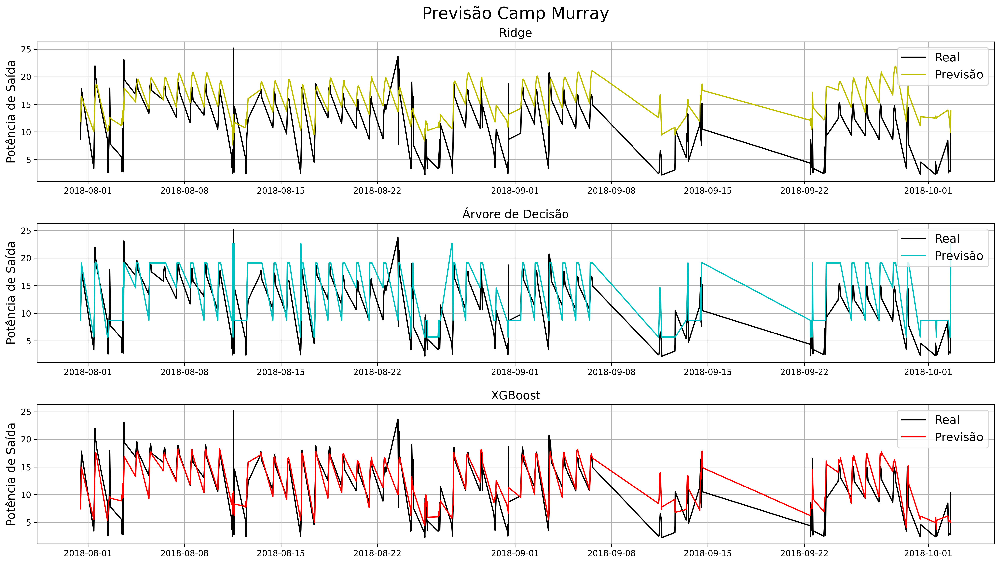

RL Erro Médio Absoluto =  4.499758966690529
RL Erro Quadrado Médio =  28.561311834527647
RL R² =  0.1219601132102619
RL Median absolute error =  4.1187940346734235
CLF Erro Médio Absoluto =  3.7369925493571032
CLF Erro Quadrado Médio =  24.25700572667009
CLF R² =  0.2542843029935472
CLF Median absolute error =  3.09355708589112
XGB Erro Médio Absoluto =  2.4684162444533846
XGB Erro Quadrado Médio =  11.410931970605958
XGB R² =  0.6492019178361399
XGB Median absolute error =  1.901088491668701


In [ ]:
## Camp Murray  1

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg1 = Ridge(normalize=True, alpha=0.5)
X1_train['DateTime'] = X1_train['DateTime'].values.astype(float)
X1_test['DateTime'] = X1_test['DateTime'].values.astype(float)
linear_reg1.fit(X1_train, y1_train)
y1_pred_linear = linear_reg1.predict(X1_test)


# Árvore de decisão
clf1 = tree.DecisionTreeRegressor(max_depth=3)
clf1.fit(X1_train,y1_train)

y1_pred_clf = clf1.predict(X1_test)

# XGBoost
XGB1 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB1.fit(X1_train, y1_train, verbose=False)

y1_pred_XGB = XGB1.predict(X1_test)

# PLOT 

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão Camp Murray', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date1_test, y1_test, color='k')
plt.plot(date1_test, y1_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date1_test, y1_test, color='k')
plt.plot(date1_test, y1_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date1_test, y1_test, color='k')
plt.plot(date1_test, y1_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y1_test, y1_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y1_test, y1_pred_linear))
print("RL R² = ", r2_score(y1_test, y1_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y1_test, y1_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y1_test, y1_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y1_test, y1_pred_clf))
print("CLF R² = ", r2_score(y1_test, y1_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y1_test, y1_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y1_test, y1_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y1_test, y1_pred_XGB))
print("XGB R² = ", r2_score(y1_test, y1_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y1_test, y1_pred_XGB))


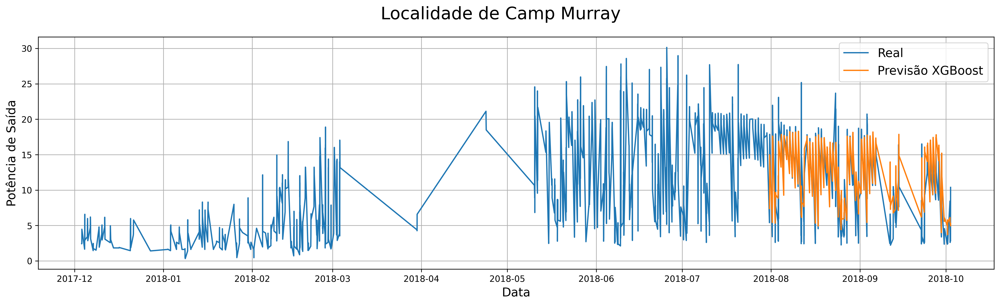

In [ ]:
plt.figure(figsize=(20,5), dpi=300)
plt.grid(True)
plt.suptitle('Localidade de Camp Murray', fontsize=20)
plt.ylabel('Potência de Saída', fontsize=14)
plt.xlabel('Data', fontsize=14)
plt.plot(date1, Camp_Murray['PolyPwr'])
plt.plot(date1_test, y1_pred_XGB)
plt.legend(['Real', 'Previsão XGBoost'], fontsize=14, loc=1)
plt.show()

/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:18:39] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


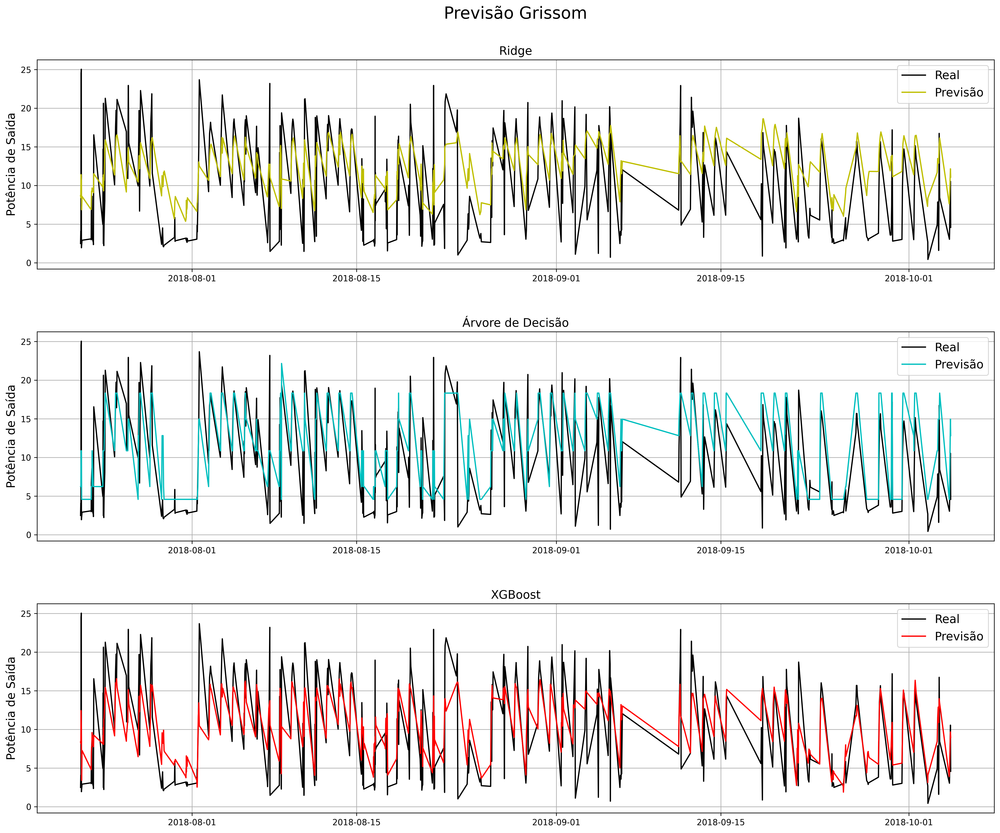

RL Erro Médio Absoluto =  4.356490512067933
RL Erro Quadrado Médio =  27.83628704110073
RL R² =  0.30291523426723443
RL Median absolute error =  3.8493869801987506
CLF Erro Médio Absoluto =  3.532630966588911
CLF Erro Quadrado Médio =  23.894062821818697
CLF R² =  0.40163761208675786
CLF Median absolute error =  2.4845714285714298
XGB Erro Médio Absoluto =  3.411190470706505
XGB Erro Quadrado Médio =  19.684724493654585
XGB R² =  0.5070491426563967
XGB Median absolute error =  2.7382244714355473


In [ ]:
## Grissom  2

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg2 = Ridge(normalize=True, alpha=0.5)
X2_train['DateTime'] = X2_train['DateTime'].values.astype(float)
X2_test['DateTime'] = X2_test['DateTime'].values.astype(float)
linear_reg2.fit(X2_train, y2_train)
y2_pred_linear = linear_reg2.predict(X2_test)


# Árvore de decisão
clf2 = tree.DecisionTreeRegressor(max_depth=3)
clf2.fit(X2_train,y2_train)

y2_pred_clf = clf2.predict(X2_test)

# XGBoost
XGB2 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB2.fit(X2_train, y2_train, verbose=False)

y2_pred_XGB = XGB2.predict(X2_test)

# PLOT 

plt.figure(figsize=(20,15), dpi=300)
plt.suptitle('Previsão Grissom', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date2_test, y2_test, color='k')
plt.plot(date2_test, y2_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date2_test, y2_test, color='k')
plt.plot(date2_test, y2_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date2_test, y2_test, color='k')
plt.plot(date2_test, y2_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y2_test, y2_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y2_test, y2_pred_linear))
print("RL R² = ", r2_score(y2_test, y2_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y2_test, y2_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y2_test, y2_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y2_test, y2_pred_clf))
print("CLF R² = ", r2_score(y2_test, y2_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y2_test, y2_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y2_test, y2_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y2_test, y2_pred_XGB))
print("XGB R² = ", r2_score(y2_test, y2_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y2_test, y2_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:19:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


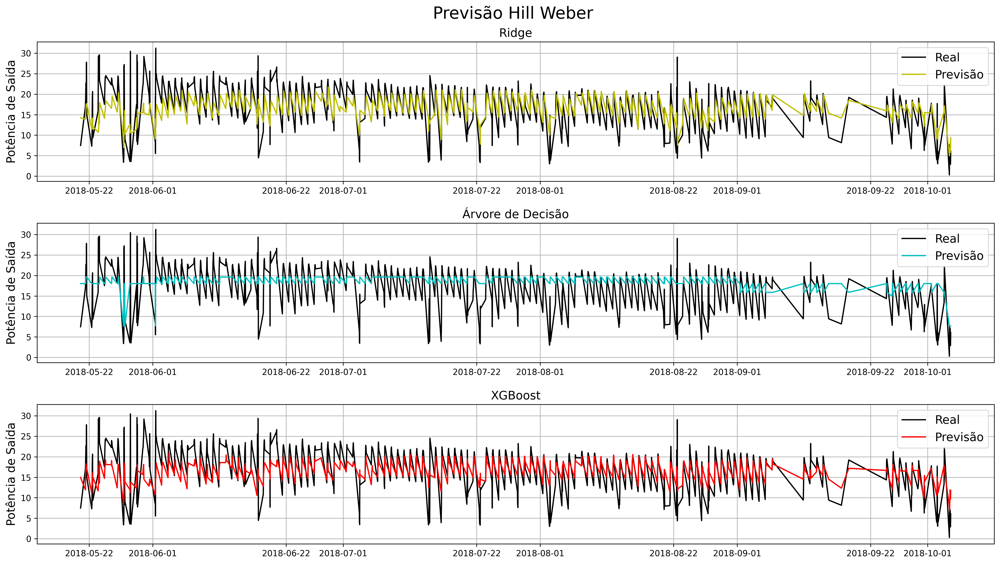

RL Erro Médio Absoluto =  3.6889742390582554
RL Erro Quadrado Médio =  23.043995317645695
RL R² =  0.3597221561877051
RL Median absolute error =  2.9446616284997003
CLF Erro Médio Absoluto =  4.348242387513204
CLF Erro Quadrado Médio =  32.86252133960632
CLF R² =  0.08691422578763375
CLF Median absolute error =  3.178399655172404
XGB Erro Médio Absoluto =  3.685648041571079
XGB Erro Quadrado Médio =  22.958716044752446
XGB R² =  0.36209164239082703
XGB Median absolute error =  2.7953533921813962


In [ ]:
## Hill_Weber  3

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg3 = Ridge(normalize=True, alpha=0.5)
X3_train['DateTime'] = X3_train['DateTime'].values.astype(float)
X3_test['DateTime'] = X3_test['DateTime'].values.astype(float)
linear_reg3.fit(X3_train, y3_train)
y3_pred_linear = linear_reg3.predict(X3_test)


# Árvore de decisão
clf3 = tree.DecisionTreeRegressor(max_depth=3)
clf3.fit(X3_train,y3_train)

y3_pred_clf = clf3.predict(X3_test)

# XGBoost
XGB3 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB3.fit(X3_train, y3_train, verbose=False)

y3_pred_XGB = XGB3.predict(X3_test)

# PLOT 

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão Hill Weber ', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date3_test, y3_test, color='k')
plt.plot(date3_test, y3_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date3_test, y3_test, color='k')
plt.plot(date3_test, y3_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date3_test, y3_test, color='k')
plt.plot(date3_test, y3_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y3_test, y3_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y3_test, y3_pred_linear))
print("RL R² = ", r2_score(y3_test, y3_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y3_test, y3_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y3_test, y3_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y3_test, y3_pred_clf))
print("CLF R² = ", r2_score(y3_test, y3_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y3_test, y3_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y3_test, y3_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y3_test, y3_pred_XGB))
print("XGB R² = ", r2_score(y3_test, y3_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y3_test, y3_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:20:16] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


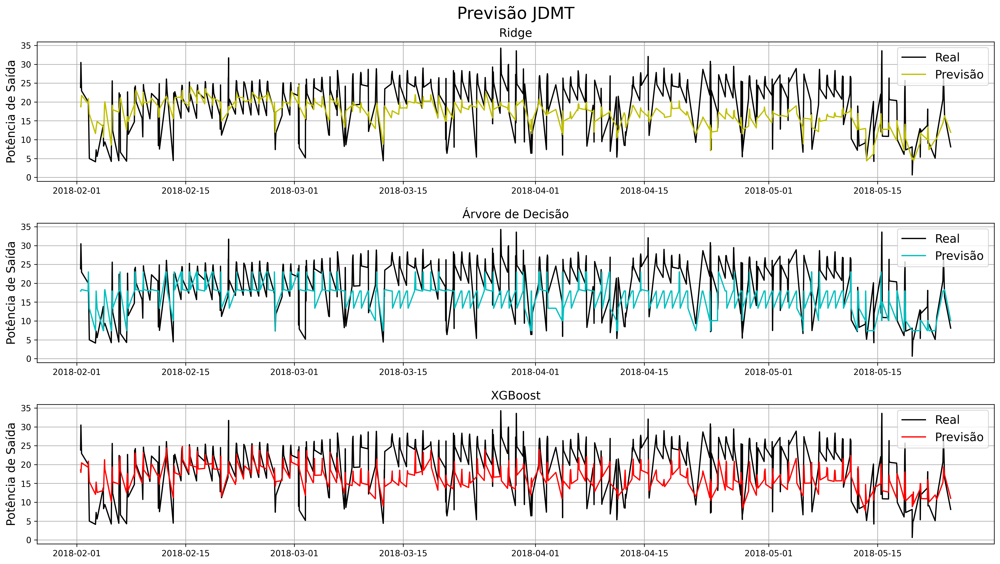

RL Erro Médio Absoluto =  5.663258655092287
RL Erro Quadrado Médio =  45.15152708273058
RL R² =  0.10921139676360869
RL Median absolute error =  5.185276636605225
CLF Erro Médio Absoluto =  5.918896322751779
CLF Erro Quadrado Médio =  50.32580526824846
CLF R² =  0.007128735656961371
CLF Median absolute error =  5.533549162711449
XGB Erro Médio Absoluto =  5.7747404057934935
XGB Erro Quadrado Médio =  44.137925081920756
XGB R² =  0.12920861875976875
XGB Median absolute error =  5.7365411013793945


In [ ]:
## JDMT  4

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg4 = Ridge(normalize=True, alpha=0.5)
X4_train['DateTime'] = X4_train['DateTime'].values.astype(float)
X4_test['DateTime'] = X4_test['DateTime'].values.astype(float)
linear_reg4.fit(X4_train, y4_train)
y4_pred_linear = linear_reg4.predict(X4_test)


# Árvore de decisão
clf4 = tree.DecisionTreeRegressor(max_depth=3)
clf4.fit(X4_train,y4_train)

y4_pred_clf = clf4.predict(X4_test)

# XGBoost
XGB4 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB4.fit(X4_train, y4_train, verbose=False)

y4_pred_XGB = XGB4.predict(X4_test)

# PLOT 

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão JDMT', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date4_test, y4_test, color='k')
plt.plot(date4_test, y4_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date4_test, y4_test, color='k')
plt.plot(date4_test, y4_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date4_test, y4_test, color='k')
plt.plot(date4_test, y4_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y4_test, y4_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y4_test, y4_pred_linear))
print("RL R² = ", r2_score(y4_test, y4_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y4_test, y4_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y4_test, y4_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y4_test, y4_pred_clf))
print("CLF R² = ", r2_score(y4_test, y4_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y4_test, y4_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y4_test, y4_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y4_test, y4_pred_XGB))
print("XGB R² = ", r2_score(y4_test, y4_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y4_test, y4_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:20:50] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


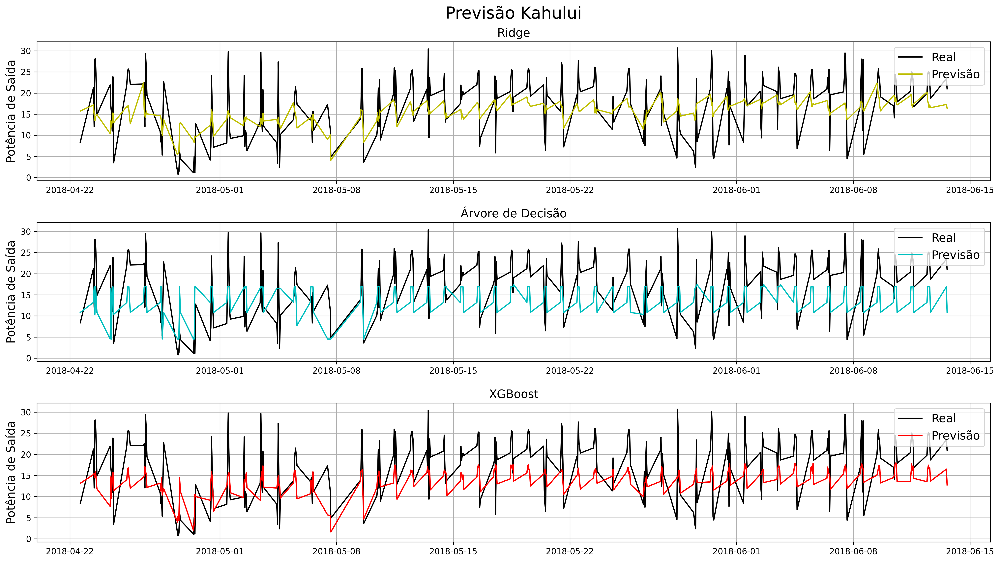

RL Erro Médio Absoluto =  5.39244353621691
RL Erro Quadrado Médio =  40.99238204387998
RL R² =  0.22654546687619148
RL Median absolute error =  5.191552717737604
CLF Erro Médio Absoluto =  6.45570212866269
CLF Erro Quadrado Médio =  52.67045490708557
CLF R² =  0.006200662699459958
CLF Median absolute error =  6.73759458666667
XGB Erro Médio Absoluto =  6.070059135157582
XGB Erro Quadrado Médio =  47.620966927634136
XGB R² =  0.10147566680827769
XGB Median absolute error =  6.141579781188966


In [ ]:
## Kahului  5

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg5 = Ridge(normalize=True, alpha=0.5)
X5_train['DateTime'] = X5_train['DateTime'].values.astype(float)
X5_test['DateTime'] = X5_test['DateTime'].values.astype(float)
linear_reg5.fit(X5_train, y5_train)
y5_pred_linear = linear_reg5.predict(X5_test)


# Árvore de decisão
clf5 = tree.DecisionTreeRegressor(max_depth=3)
clf5.fit(X5_train,y5_train)

y5_pred_clf = clf5.predict(X5_test)

# XGBoost
XGB5 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB5.fit(X5_train, y5_train, verbose=False)

y5_pred_XGB = XGB5.predict(X5_test)

# PLOT  

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão Kahului', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date5_test, y5_test, color='k')
plt.plot(date5_test, y5_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date5_test, y5_test, color='k')
plt.plot(date5_test, y5_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date5_test, y5_test, color='k')
plt.plot(date5_test, y5_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y5_test, y5_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y5_test, y5_pred_linear))
print("RL R² = ", r2_score(y5_test, y5_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y5_test, y5_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y5_test, y5_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y5_test, y5_pred_clf))
print("CLF R² = ", r2_score(y5_test, y5_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y5_test, y5_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y5_test, y5_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y5_test, y5_pred_XGB))
print("XGB R² = ", r2_score(y5_test, y5_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y5_test, y5_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:21:32] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


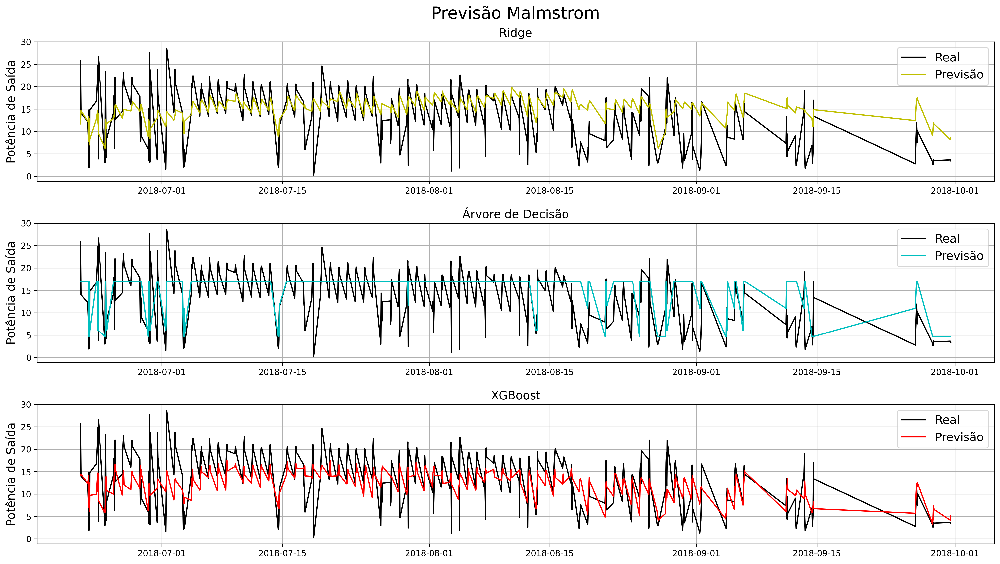

RL Erro Médio Absoluto =  4.375977590691174
RL Erro Quadrado Médio =  32.23569816036234
RL R² =  0.17715426740596496
RL Median absolute error =  3.3523878398759974
CLF Erro Médio Absoluto =  4.313743683687061
CLF Erro Quadrado Médio =  33.50810457836332
CLF R² =  0.14467492770099222
CLF Median absolute error =  3.09919
XGB Erro Médio Absoluto =  4.388959407421581
XGB Erro Quadrado Médio =  27.561083686093404
XGB R² =  0.2964780851355966
XGB Median absolute error =  3.8709812228393545


In [ ]:
## Malmstrom 6

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg6 = Ridge(normalize=True, alpha=0.5)
X6_train['DateTime'] = X6_train['DateTime'].values.astype(float)
X6_test['DateTime'] = X6_test['DateTime'].values.astype(float)
linear_reg6.fit(X6_train, y6_train)
y6_pred_linear = linear_reg6.predict(X6_test)


# Árvore de decisão
clf6 = tree.DecisionTreeRegressor(max_depth=3)
clf6.fit(X6_train,y6_train)

y6_pred_clf = clf6.predict(X6_test)

# XGBoost
XGB6 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB6.fit(X6_train, y6_train, verbose=False)

y6_pred_XGB = XGB6.predict(X6_test)

# PLOT  

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão Malmstrom', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date6_test, y6_test, color='k')
plt.plot(date6_test, y6_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date6_test, y6_test, color='k')
plt.plot(date6_test, y6_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date6_test, y6_test, color='k')
plt.plot(date6_test, y6_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y6_test, y6_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y6_test, y6_pred_linear))
print("RL R² = ", r2_score(y6_test, y6_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y6_test, y6_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y6_test, y6_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y6_test, y6_pred_clf))
print("CLF R² = ", r2_score(y6_test, y6_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y6_test, y6_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y6_test, y6_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y6_test, y6_pred_XGB))
print("XGB R² = ", r2_score(y6_test, y6_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y6_test, y6_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:22:01] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


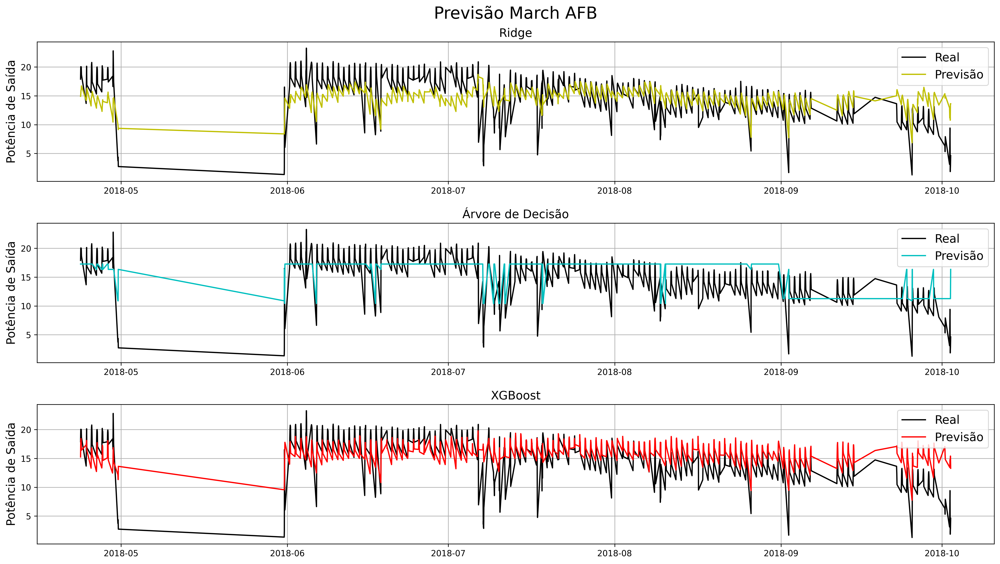

RL Erro Médio Absoluto =  2.7972205943804376
RL Erro Quadrado Médio =  12.816101706047695
RL R² =  0.20724506863645076
RL Median absolute error =  2.150316050031745
CLF Erro Médio Absoluto =  2.537445995558495
CLF Erro Quadrado Médio =  11.841005271182865
CLF R² =  0.2675607968527256
CLF Median absolute error =  1.9885684490238642
XGB Erro Médio Absoluto =  2.5298293911777736
XGB Erro Quadrado Médio =  11.488038265005825
XGB R² =  0.2893939830409591
XGB Median absolute error =  2.0066390133666996


In [ ]:
## March AFB 7

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg7 = Ridge(normalize=True, alpha=0.5)
X7_train['DateTime'] = X7_train['DateTime'].values.astype(float)
X7_test['DateTime'] = X7_test['DateTime'].values.astype(float)
linear_reg7.fit(X7_train, y7_train)
y7_pred_linear = linear_reg7.predict(X7_test)


# Árvore de decisão
clf7 = tree.DecisionTreeRegressor(max_depth=3)
clf7.fit(X7_train,y7_train)

y7_pred_clf = clf7.predict(X7_test)

# XGBoost
XGB7 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB7.fit(X7_train, y7_train, verbose=False)

y7_pred_XGB = XGB7.predict(X7_test)

# PLOT  

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão March AFB', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date7_test, y7_test, color='k')
plt.plot(date7_test, y7_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date7_test, y7_test, color='k')
plt.plot(date7_test, y7_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date7_test, y7_test, color='k')
plt.plot(date7_test, y7_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y7_test, y7_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y7_test, y7_pred_linear))
print("RL R² = ", r2_score(y7_test, y7_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y7_test, y7_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y7_test, y7_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y7_test, y7_pred_clf))
print("CLF R² = ", r2_score(y7_test, y7_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y7_test, y7_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y7_test, y7_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y7_test, y7_pred_XGB))
print("XGB R² = ", r2_score(y7_test, y7_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y7_test, y7_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:22:36] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


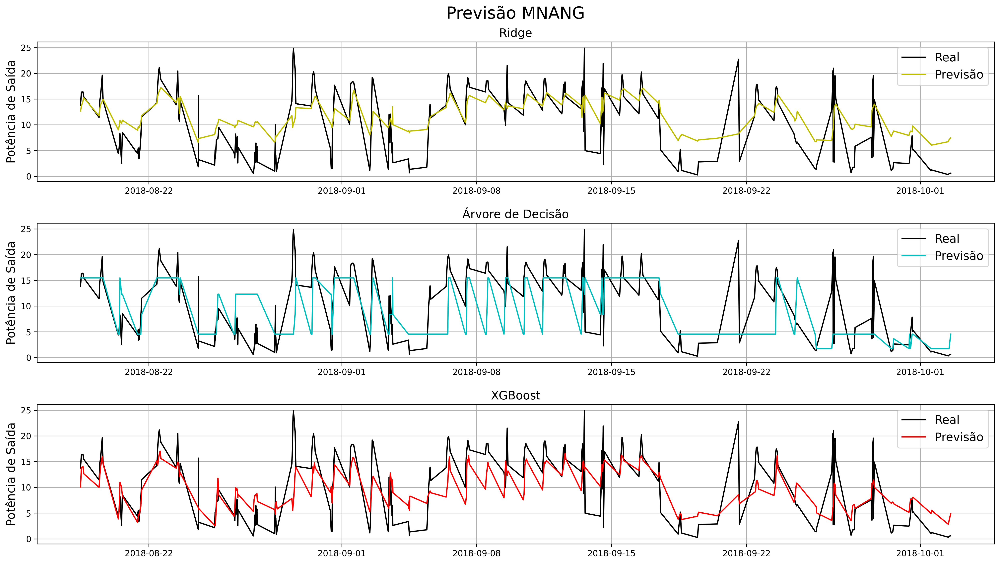

RL Erro Médio Absoluto =  4.297606425186652
RL Erro Quadrado Médio =  27.035222268863507
RL R² =  0.4388509528336104
RL Median absolute error =  4.112532487645646
CLF Erro Médio Absoluto =  4.650560933093979
CLF Erro Quadrado Médio =  39.98937922574849
CLF R² =  0.1699716086614772
CLF Median absolute error =  3.1883815309822032
XGB Erro Médio Absoluto =  4.034100132845691
XGB Erro Quadrado Médio =  25.34265145553444
XGB R² =  0.47398232662871753
XGB Median absolute error =  3.462466120910644


In [ ]:
## March MNANG  8

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg8 = Ridge(normalize=True, alpha=0.5)
X8_train['DateTime'] = X8_train['DateTime'].values.astype(float)
X8_test['DateTime'] = X8_test['DateTime'].values.astype(float)
linear_reg8.fit(X8_train, y8_train)
y8_pred_linear = linear_reg8.predict(X8_test)


# Árvore de decisão
clf8 = tree.DecisionTreeRegressor(max_depth=3)
clf8.fit(X8_train,y8_train)

y8_pred_clf = clf8.predict(X8_test)

# XGBoost
XGB8 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB8.fit(X8_train, y8_train, verbose=False)

y8_pred_XGB = XGB8.predict(X8_test)

# PLOT  

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão MNANG', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date8_test, y8_test, color='k')
plt.plot(date8_test, y8_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date8_test, y8_test, color='k')
plt.plot(date8_test, y8_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date8_test, y8_test, color='k')
plt.plot(date8_test, y8_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y8_test, y8_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y8_test, y8_pred_linear))
print("RL R² = ", r2_score(y8_test, y8_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y8_test, y8_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y8_test, y8_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y8_test, y8_pred_clf))
print("CLF R² = ", r2_score(y8_test, y8_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y8_test, y8_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y8_test, y8_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y8_test, y8_pred_XGB))
print("XGB R² = ", r2_score(y8_test, y8_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y8_test, y8_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:23:20] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


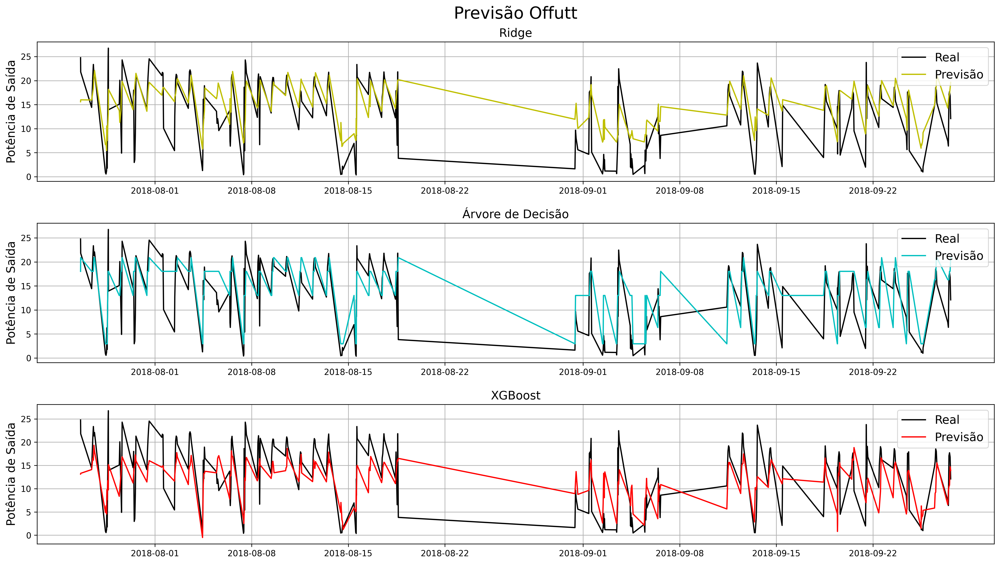

RL Erro Médio Absoluto =  4.23354288275033
RL Erro Quadrado Médio =  30.105370700393067
RL R² =  0.45432422403157613
RL Median absolute error =  3.278019768219959
CLF Erro Médio Absoluto =  4.1129415644468885
CLF Erro Quadrado Médio =  30.067453809402135
CLF R² =  0.45501148774673494
CLF Median absolute error =  2.7859072881355864
XGB Erro Médio Absoluto =  4.778797975841162
XGB Erro Quadrado Médio =  32.718989672367776
XGB R² =  0.4069509970146613
XGB Median absolute error =  4.294368217163086


In [ ]:
## March Offutt   9

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg9 = Ridge(normalize=True, alpha=0.5)
X9_train['DateTime'] = X9_train['DateTime'].values.astype(float)
X9_test['DateTime'] = X9_test['DateTime'].values.astype(float)
linear_reg9.fit(X9_train, y9_train)
y9_pred_linear = linear_reg9.predict(X9_test)


# Árvore de decisão
clf9 = tree.DecisionTreeRegressor(max_depth=3)
clf9.fit(X9_train,y9_train)

y9_pred_clf = clf9.predict(X9_test)

# XGBoost
XGB9 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB9.fit(X9_train, y9_train, verbose=False)

y9_pred_XGB = XGB9.predict(X9_test)

# PLOT  

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão Offutt', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date9_test, y9_test, color='k')
plt.plot(date9_test, y9_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date9_test, y9_test, color='k')
plt.plot(date9_test, y9_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date9_test, y9_test, color='k')
plt.plot(date9_test, y9_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y9_test, y9_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y9_test, y9_pred_linear))
print("RL R² = ", r2_score(y9_test, y9_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y9_test, y9_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y9_test, y9_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y9_test, y9_pred_clf))
print("CLF R² = ", r2_score(y9_test, y9_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y9_test, y9_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y9_test, y9_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y9_test, y9_pred_XGB))
print("XGB R² = ", r2_score(y9_test, y9_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y9_test, y9_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:24:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


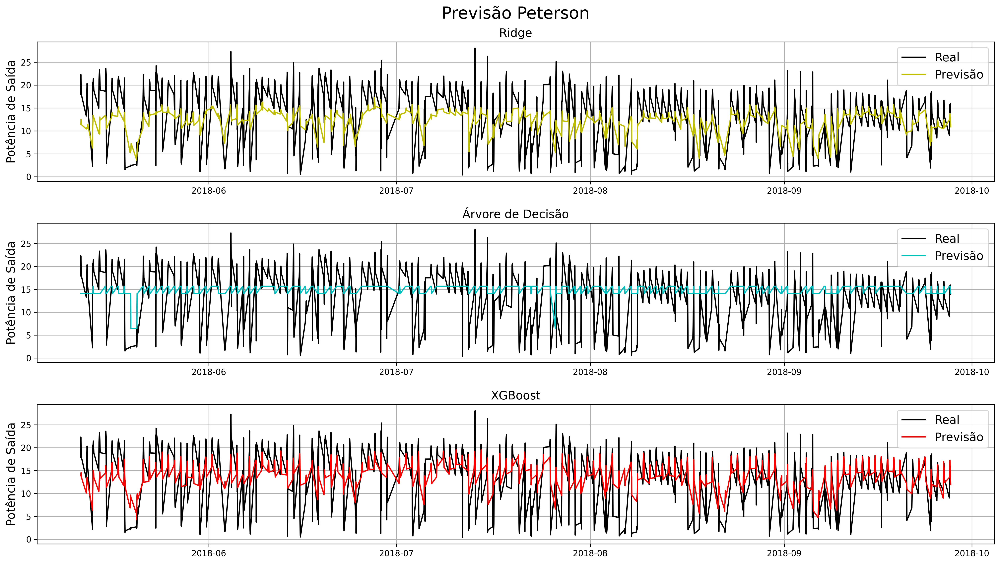

RL Erro Médio Absoluto =  5.022418888623861
RL Erro Quadrado Médio =  34.405928872269286
RL R² =  0.2853709344819424
RL Median absolute error =  4.879677473671197
CLF Erro Médio Absoluto =  5.422861727496985
CLF Erro Quadrado Médio =  44.043198927399516
CLF R² =  0.08519981516088349
CLF Median absolute error =  4.61828825454546
XGB Erro Médio Absoluto =  4.463335471455352
XGB Erro Quadrado Médio =  31.584479984995536
XGB R² =  0.3439738976283466
XGB Median absolute error =  3.607837745971681


In [ ]:
## Peterson  10

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg10 = Ridge(normalize=True, alpha=0.5)
X10_train['DateTime'] = X10_train['DateTime'].values.astype(float)
X10_test['DateTime'] = X10_test['DateTime'].values.astype(float)
linear_reg10.fit(X10_train, y10_train)
y10_pred_linear = linear_reg10.predict(X10_test)


# Árvore de decisão
clf10 = tree.DecisionTreeRegressor(max_depth=3)
clf10.fit(X10_train,y10_train)

y10_pred_clf = clf10.predict(X10_test)

# XGBoost
XGB10 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB10.fit(X10_train, y10_train, verbose=False)

y10_pred_XGB = XGB10.predict(X10_test)

# PLOT  

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão Peterson', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date10_test, y10_test, color='k')
plt.plot(date10_test, y10_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date10_test, y10_test, color='k')
plt.plot(date10_test, y10_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date10_test, y10_test, color='k')
plt.plot(date10_test, y10_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y10_test, y10_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y10_test, y10_pred_linear))
print("RL R² = ", r2_score(y10_test, y10_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y10_test, y10_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y10_test, y10_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y10_test, y10_pred_clf))
print("CLF R² = ", r2_score(y10_test, y10_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y10_test, y10_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y10_test, y10_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y10_test, y10_pred_XGB))
print("XGB R² = ", r2_score(y10_test, y10_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y10_test, y10_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:24:34] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


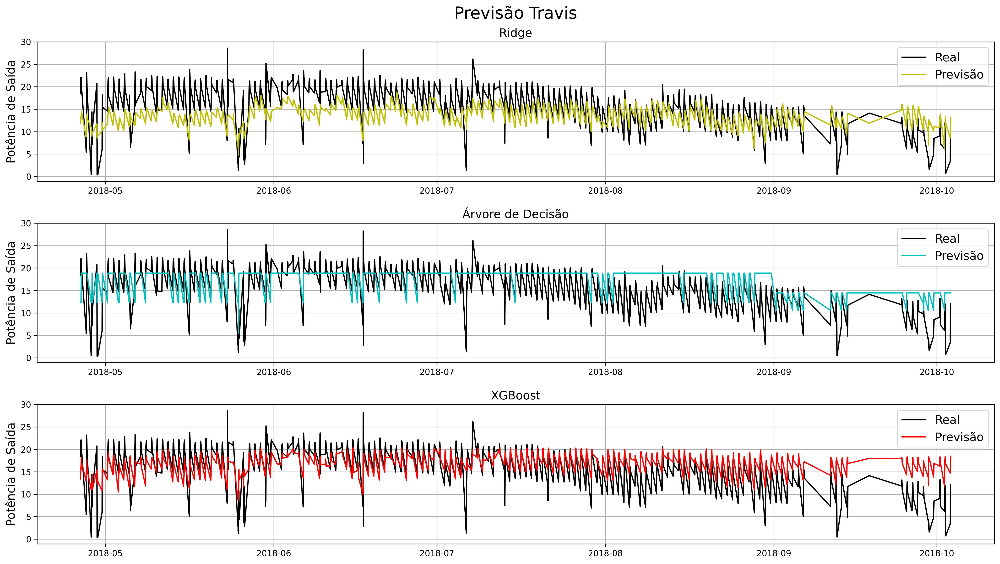

RL Erro Médio Absoluto =  4.040636464195833
RL Erro Quadrado Médio =  22.887361157646353
RL R² =  0.07254830556441916
RL Median absolute error =  3.786901233552898
CLF Erro Médio Absoluto =  3.1787952153126313
CLF Erro Quadrado Médio =  19.20802813508257
CLF R² =  0.22164385321909186
CLF Median absolute error =  2.424818578188092
XGB Erro Médio Absoluto =  3.122590743068954
XGB Erro Quadrado Médio =  17.17756668327394
XGB R² =  0.30392310336920836
XGB Median absolute error =  2.4266538021850597


In [ ]:
## Travis  11

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg11 = Ridge(normalize=True, alpha=0.5)
X11_train['DateTime'] = X11_train['DateTime'].values.astype(float)
X11_test['DateTime'] = X11_test['DateTime'].values.astype(float)
linear_reg11.fit(X11_train, y11_train)
y11_pred_linear = linear_reg11.predict(X11_test)


# Árvore de decisão
clf11 = tree.DecisionTreeRegressor(max_depth=3)
clf11.fit(X11_train,y11_train)

y11_pred_clf = clf11.predict(X11_test)

# XGBoost
XGB11 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB11.fit(X11_train, y11_train, verbose=False)

y11_pred_XGB = XGB11.predict(X11_test)

# PLOT  

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão Travis', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date11_test, y11_test, color='k')
plt.plot(date11_test, y11_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date11_test, y11_test, color='k')
plt.plot(date11_test, y11_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date11_test, y11_test, color='k')
plt.plot(date11_test, y11_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y11_test, y11_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y11_test, y11_pred_linear))
print("RL R² = ", r2_score(y11_test, y11_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y11_test, y11_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y11_test, y11_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y11_test, y11_pred_clf))
print("CLF R² = ", r2_score(y11_test, y11_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y11_test, y11_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y11_test, y11_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y11_test, y11_pred_XGB))
print("XGB R² = ", r2_score(y11_test, y11_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y11_test, y11_pred_XGB))


/usr/local/lib/python3.8/dist-packages/sklearn/linear_model/_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), Ridge())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * n_samples. 
  warnings.warn(


[18:25:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


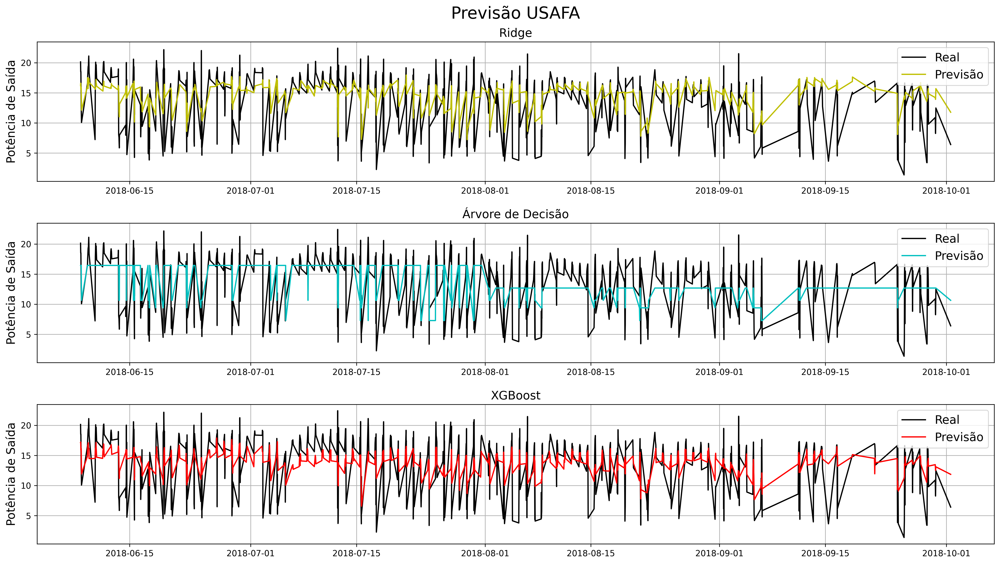

RL Erro Médio Absoluto =  3.1515035784415173
RL Erro Quadrado Médio =  17.42207129754387
RL R² =  0.25772153738367143
RL Median absolute error =  2.3411070015519755
CLF Erro Médio Absoluto =  3.5707992382900247
CLF Erro Quadrado Médio =  20.55633809790037
CLF R² =  0.12418410074569797
CLF Median absolute error =  2.9528293853170515
XGB Erro Médio Absoluto =  3.2127881166964123
XGB Erro Quadrado Médio =  16.40794706507248
XGB R² =  0.3009289473020862
XGB Median absolute error =  2.562961903228759


In [ ]:
## USAFA  12

# Regressão Linear (Ridge)
sklearn.linear_model.Ridge = Ridge
linear_reg12 = Ridge(normalize=True, alpha=0.5)
X12_train['DateTime'] = X12_train['DateTime'].values.astype(float)
X12_test['DateTime'] = X12_test['DateTime'].values.astype(float)
linear_reg12.fit(X12_train, y12_train)
y12_pred_linear = linear_reg12.predict(X12_test)


# Árvore de decisão
clf12 = tree.DecisionTreeRegressor(max_depth=3)
clf12.fit(X12_train,y12_train)

y12_pred_clf = clf12.predict(X12_test)

# XGBoost
XGB12 = XGBRegressor(booster = "gbtree", eta = 0.01, max_depth=3, colsample_bytree = 0.1, gamma = 0.5)
XGB12.fit(X12_train, y12_train, verbose=False)

y12_pred_XGB = XGB12.predict(X12_test)

# PLOT  

plt.figure(figsize=(20,10), dpi=300)
plt.suptitle('Previsão USAFA', fontsize=20)


# linear
plt.subplot(311)
plt.plot(date12_test, y12_test, color='k')
plt.plot(date12_test, y12_pred_linear,  color='y')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Ridge', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# árvore
plt.subplot(312)
plt.plot(date12_test, y12_test, color='k')
plt.plot(date12_test, y12_pred_clf, color='c')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('Árvore de Decisão', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)

# XGBoost
plt.subplot(313)
plt.plot(date12_test, y12_test, color='k')
plt.plot(date12_test, y12_pred_XGB,  color='r')
plt.ylabel('Potência de Saída', fontsize=14)
plt.title('XGBoost', fontsize=14)
plt.grid(True)
plt.legend(['Real', 'Previsão'], fontsize=14, loc=1)
plt.subplots_adjust(top=0.92, bottom=0.08, left=0.1, right=0.9, hspace=0.3, wspace=0.1)

plt.show()

print("RL Erro Médio Absoluto = ", (mean_absolute_error(y12_test, y12_pred_linear)))
print("RL Erro Quadrado Médio = ", mean_squared_error(y12_test, y12_pred_linear))
print("RL R² = ", r2_score(y12_test, y12_pred_linear)),
print("RL Median absolute error = ", metrics.median_absolute_error(y12_test, y12_pred_linear))

print("CLF Erro Médio Absoluto = ", (mean_absolute_error(y12_test, y12_pred_clf)))
print("CLF Erro Quadrado Médio = ", mean_squared_error(y12_test, y12_pred_clf))
print("CLF R² = ", r2_score(y12_test, y12_pred_clf)),
print("CLF Median absolute error = ", metrics.median_absolute_error(y12_test, y12_pred_clf))

print("XGB Erro Médio Absoluto = ", (mean_absolute_error(y12_test, y12_pred_XGB)))
print("XGB Erro Quadrado Médio = ", mean_squared_error(y12_test, y12_pred_XGB))
print("XGB R² = ", r2_score(y12_test, y12_pred_XGB)),
print("XGB Median absolute error = ", metrics.median_absolute_error(y12_test, y12_pred_XGB))
